# **Clasificador de Perros y Gatos**


**Proceso**

1. Datos de entrenamiento
2. Arquitectura Hiperparámetros -> Capas de las redes neuronales.
3. Exportar el formato a HTML
4. Crear el fotmato para poder usarlo con un celular
5. Publicar el sitio


**Modelo** [Cats vs Dogs](https://www.tensorflow.org/datasets/catalog/cats_vs_dogs)


Traerse los datos de las librerias y datasets originales

In [ ]:
#Importar el dataset
import tensorflow as tf
import tensorflow_datasets as td
import cv2

#Importar matplotlib
import matplotlib.pyplot as plt

In [ ]:
#Descargar el modelo
datos, metadatos = td.load('cats_vs_dogs', as_supervised=True, with_info=True)

Analizar el set de datos

In [ ]:
metadatos

tfds.core.DatasetInfo(
    name='cats_vs_dogs',
    full_name='cats_vs_dogs/4.0.1',
    description="""
    A large set of images of cats and dogs. There are 1738 corrupted images that are dropped.
    """,
    homepage='https://www.microsoft.com/en-us/download/details.aspx?id=54765',
    data_dir='/root/tensorflow_datasets/cats_vs_dogs/4.0.1',
    file_format=tfrecord,
    download_size=Unknown size,
    dataset_size=1.04 GiB,
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=uint8),
        'image/filename': Text(shape=(), dtype=string),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=2),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    splits={
        'train': <SplitInfo num_examples=23262, num_shards=16>,
    },
    citation="""@Inproceedings (Conference){asirra-a-captcha-that-exploits-interest-aligned-manual-image-categorization,
    author = {Elson, Jeremy and Douceur, John (JD) and Howell, Jon and Saul

Es un set de datos diseñado por Microsoft, tiene una imágen, un nombre de archivo y una etiqueta. Además de que tiene una imagen y una etiqueta que hacen parte de los datos de aprendizaje supervisado. Los datos son del año 2007 de la Asociación de Computación para Máquina.

## Preparar las imágenes

Vamos a convertir el data frame a tensor para trabajar el entrenamiento del modelo

Luego mostramos los datos del Data Frame

,image,label
0,,1 (dog)
1,,1 (dog)
2,,1 (dog)
3,,0 (cat)
4,,1 (dog)

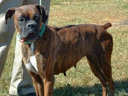
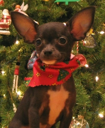
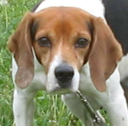
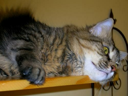
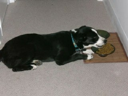

In [ ]:
#Ver los datos convirtiendolo a un DataFrame
td.as_dataframe(datos['train'].take(5), metadatos)

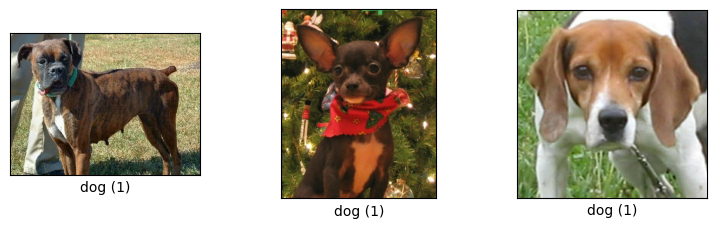

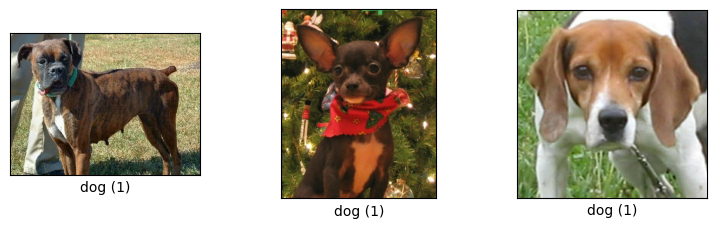

In [ ]:
#Para poner la etiqueta abajo, usamos show_examples
td.show_examples(datos['train'].take(3), metadatos)

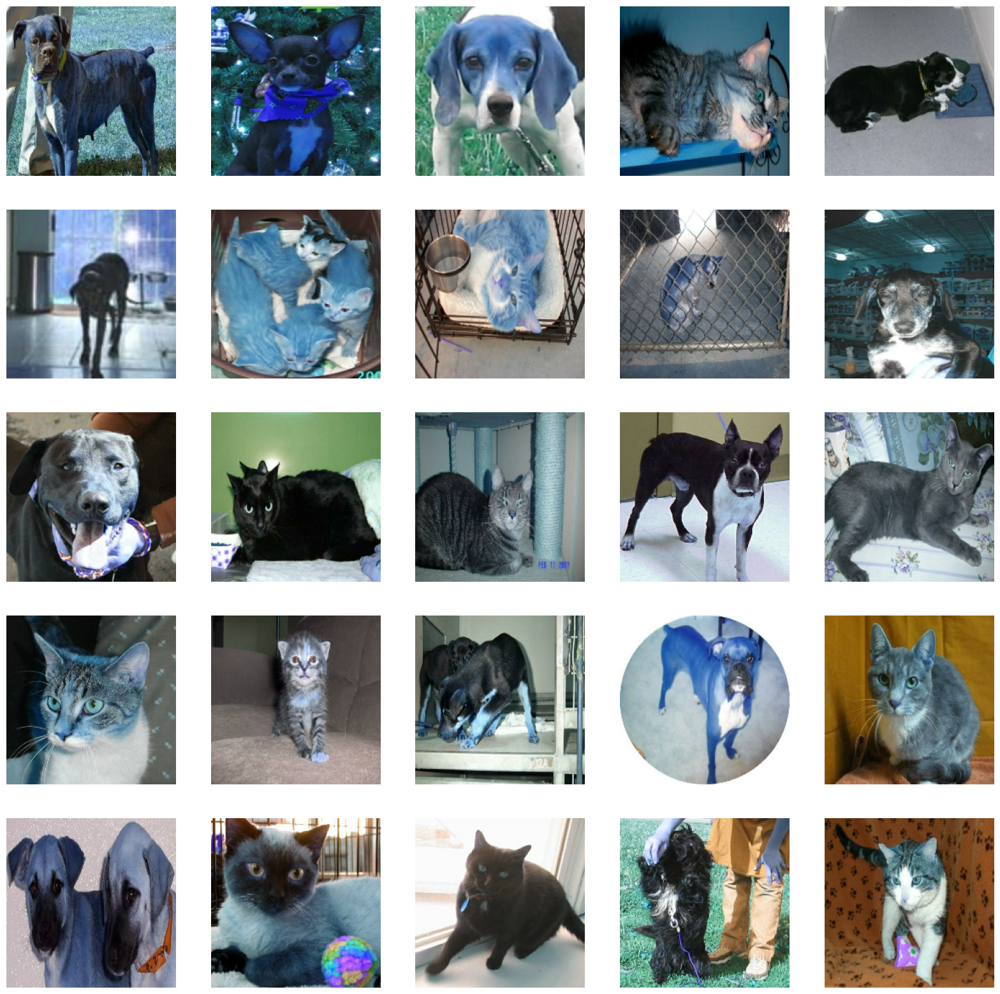

In [ ]:
#Iterar en los datos
# Indice y el par de la imagen con su etiqueta

plt.figure(figsize=(20,20))

TAMANO_IMGEN = 200

#Desactivar las etiquetas y los ejes del arreglo de las imágenes
for i, (imagen, etiqueta) in enumerate(datos['train'].take(25)):
  imagen = cv2.resize(imagen.numpy(), (TAMANO_IMGEN, TAMANO_IMGEN))
  imagen = cv2.cvtColor(imagen, cv2.COLOR_BGR2RGB)
  plt.subplot(5,5, i +1)
  plt.axis('off')
  plt.xticks([])
  plt.yticks([])
  plt.imshow(imagen)


Para entrenar correctamente la red neuronal, todas las imágenes deben tener el mismo tamaño

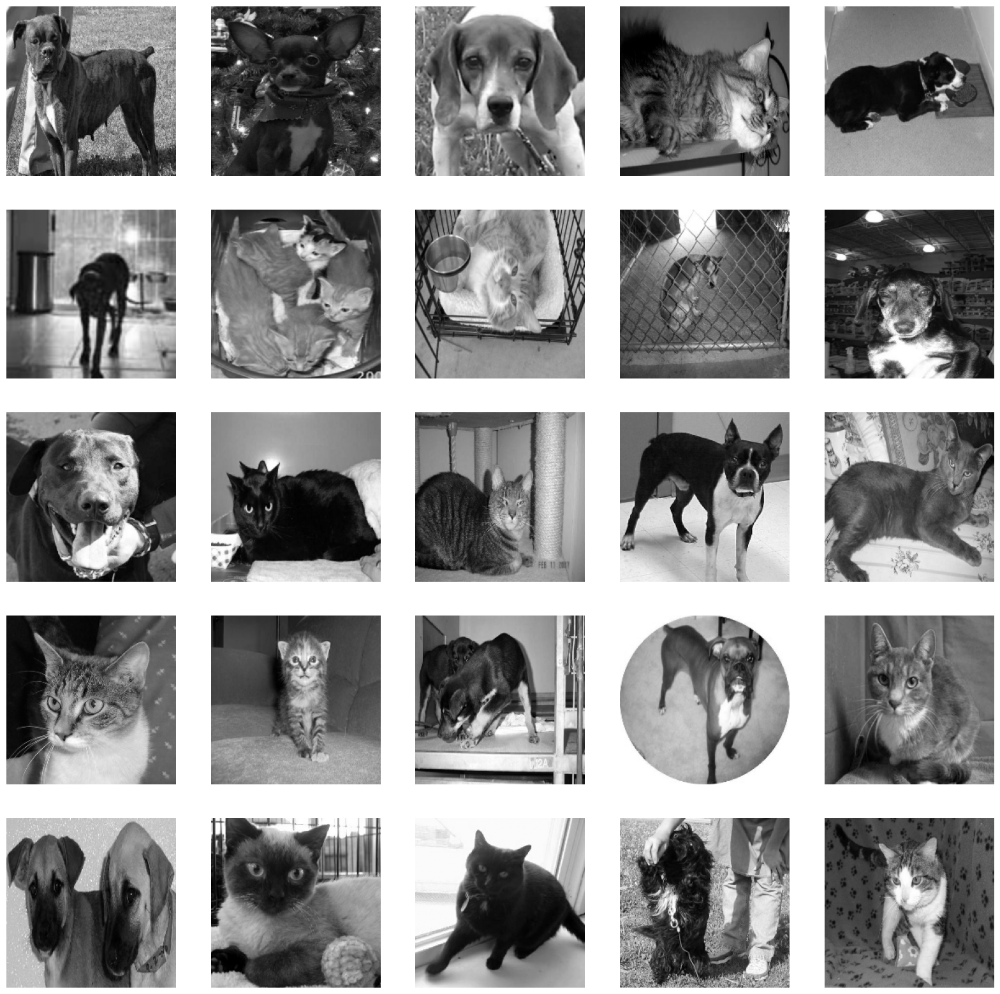

In [ ]:
#Redimensionar la red neuronal a 200 x 200 pixeles
#Iterar en los datos
# Indice y el par de la imagen con su etiqueta
plt.figure(figsize=(20,20))

TAMANO_IMGEN = 200

#Desactivar las etiquetas y los ejes del arreglo de las imágenes

#Ajustar el color de las imágenes en blanco y negro para facilitar el procesamiento de los pixeles
for i, (imagen, etiqueta) in enumerate(datos['train'].take(25)):
  imagen = cv2.resize(imagen.numpy(), (TAMANO_IMGEN, TAMANO_IMGEN))
  imagen = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
  plt.subplot(5,5, i +1)
  plt.axis('off')
  plt.xticks([])
  plt.yticks([])
  #Cmap funciona para poner las imágenes en esscalas de grises
  plt.imshow(imagen, cmap='gray')

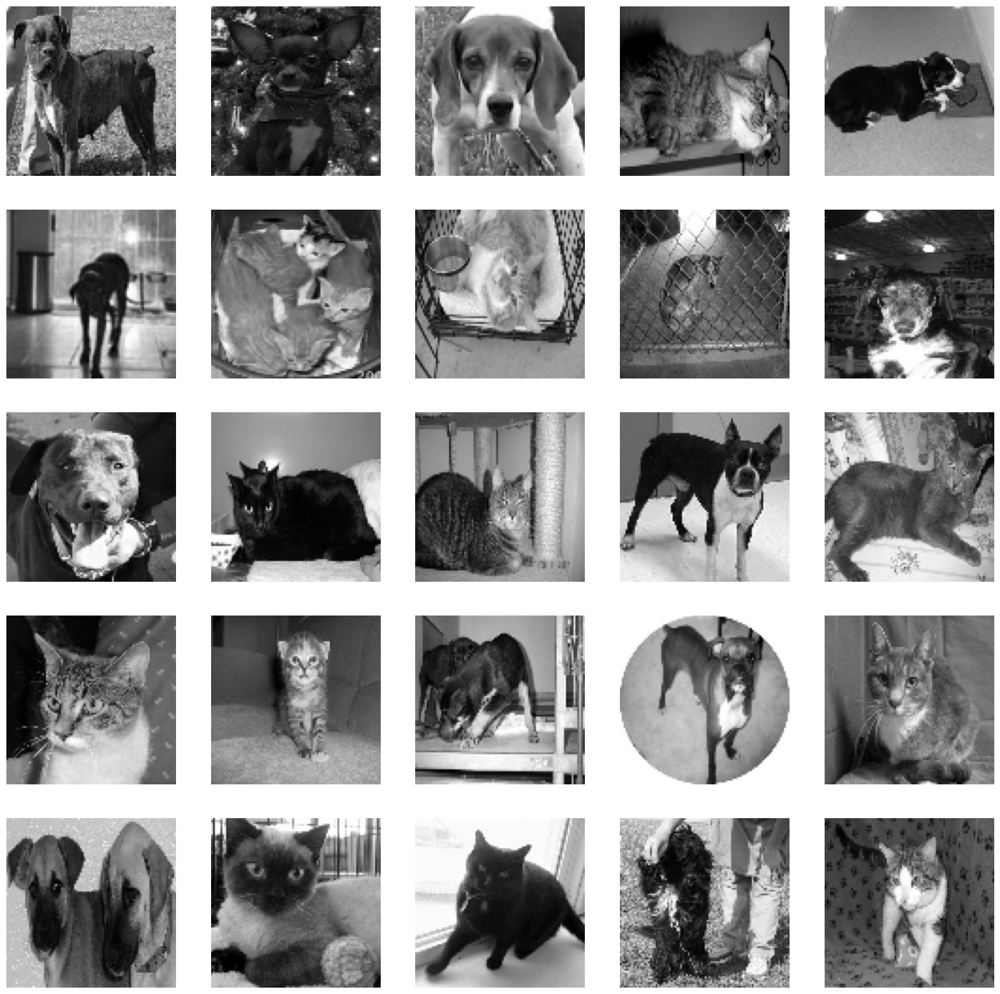

In [ ]:
#Disminuir el tamaño, pero cuidando que se puedan distinguir las caracteristicas de animales

#Redimensionar la red neuronal a 200 x 200 pixeles
#Iterar en los datos
# Indice y el par de la imagen con su etiqueta
plt.figure(figsize=(20,20))

TAMANO_IMGEN = 90

#Desactivar las etiquetas y los ejes del arreglo de las imágenes

#Ajustar el color de las imágenes en blanco y negro para facilitar el procesamiento de los pixeles
for i, (imagen, etiqueta) in enumerate(datos['train'].take(25)):
  imagen = cv2.resize(imagen.numpy(), (TAMANO_IMGEN, TAMANO_IMGEN))
  imagen = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
  plt.subplot(5,5, i +1)
  plt.axis('off')
  plt.xticks([])
  plt.yticks([])
  #Cmap funciona para poner las imágenes en esscalas de grises
  plt.imshow(imagen, cmap='gray')

Ya están todas las imágenes con el mismo tamaño y el mismo formato para hacer el entrenamiento correcto y sencillo

## Entrenar el modelo

In [ ]:
#Crear la lista donde se almacenaran los datos de entrenamiento
datos_entrenamiento = []


#Iterar en los datos
for i, (imagen, etiqueta) in enumerate(datos['train']): #Cargar todos los datos
  imagen = cv2.resize(imagen.numpy(), (TAMANO_IMGEN, TAMANO_IMGEN))
  imagen = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
  #Recordar que las imágenes solo tienen un canal de color para no confundir a la red neuronal
  imagen = imagen.reshape(TAMANO_IMGEN, TAMANO_IMGEN, 1) #Cambiar a 100 pixeles
  #Agregar los datos a los datos al arreglo
  datos_entrenamiento.append([imagen, etiqueta])

In [ ]:
#Imprimir los datos de entrenamiento
datos_entrenamiento[0]

[array([[[248],
         [169],
         [ 96],
         ...,
         [195],
         [194],
         [150]],
 
        [[222],
         [106],
         [ 86],
         ...,
         [190],
         [191],
         [191]],
 
        [[146],
         [ 87],
         [ 83],
         ...,
         [133],
         [152],
         [144]],
 
        ...,
 
        [[128],
         [120],
         [188],
         ...,
         [127],
         [161],
         [120]],
 
        [[149],
         [163],
         [157],
         ...,
         [ 75],
         [169],
         [159]],
 
        [[101],
         [ 98],
         [181],
         ...,
         [ 53],
         [ 46],
         [ 54]]], dtype=uint8),
 <tf.Tensor: shape=(), dtype=int64, numpy=1>]

In [ ]:
len(datos_entrenamiento)

23262

## Preparar los datos para el entrenamiento

In [ ]:
X = [] #Imagenes de entrada (pixeles)
y = [] #Etiquetas

for imagen, etiqueta in datos_entrenamiento:
  X.append(imagen)
  y.append(etiqueta)

In [ ]:
X

[array([[[248],
         [169],
         [ 96],
         ...,
         [195],
         [194],
         [150]],
 
        [[222],
         [106],
         [ 86],
         ...,
         [190],
         [191],
         [191]],
 
        [[146],
         [ 87],
         [ 83],
         ...,
         [133],
         [152],
         [144]],
 
        ...,
 
        [[128],
         [120],
         [188],
         ...,
         [127],
         [161],
         [120]],
 
        [[149],
         [163],
         [157],
         ...,
         [ 75],
         [169],
         [159]],
 
        [[101],
         [ 98],
         [181],
         ...,
         [ 53],
         [ 46],
         [ 54]]], dtype=uint8),
 array([[[156],
         [ 93],
         [ 93],
         ...,
         [ 88],
         [ 73],
         [ 77]],
 
        [[104],
         [ 62],
         [ 82],
         ...,
         [117],
         [ 73],
         [ 66]],
 
        [[ 84],
         [ 57],
         [ 63],
         ...,
      

Normalizar los datos -> Pasar todos los datos a la misma escala

In [ ]:
import numpy as np


#Tamaño de 255 pixeles
X = np.array(X).astype(float) / 255.0


Vamos a generar numeros aproximados a 0 y 1 -> Donde 0 será perro y 1 gato

In [ ]:
X

array([[[[0.97254902],
         [0.6627451 ],
         [0.37647059],
         ...,
         [0.76470588],
         [0.76078431],
         [0.58823529]],

        [[0.87058824],
         [0.41568627],
         [0.3372549 ],
         ...,
         [0.74509804],
         [0.74901961],
         [0.74901961]],

        [[0.57254902],
         [0.34117647],
         [0.3254902 ],
         ...,
         [0.52156863],
         [0.59607843],
         [0.56470588]],

        ...,

        [[0.50196078],
         [0.47058824],
         [0.7372549 ],
         ...,
         [0.49803922],
         [0.63137255],
         [0.47058824]],

        [[0.58431373],
         [0.63921569],
         [0.61568627],
         ...,
         [0.29411765],
         [0.6627451 ],
         [0.62352941]],

        [[0.39607843],
         [0.38431373],
         [0.70980392],
         ...,
         [0.20784314],
         [0.18039216],
         [0.21176471]]],


       [[[0.61176471],
         [0.36470588],
         [0.36

# Arquitectura e hiperparámetros del modelo
Para eso, usaremos redes nueronales convulcionales.

**¿Qué es una red neuronal convulcional?**

https://www.ibm.com/es-es/topics/convolutional-neural-networks


Las redes neuronales convulcionales utilizan datos tridimensionales para tareas de clasificación de imágenes y redireccionamiento de objetos. Se destacan por poder procesar imágenes texto y voz.

**Tipos de capas en redes neuronales convulcionales**
- *Capa Convulcional* : La capa convolucional es el bloque de creación principal de una CNN, y es donde se realizan la mayoría de los cálculos. Dentro de estos se definen los pesos de la salida, los cuáles se evaluan mediante los siguientes parámetros:
  1. **Número de filtros** Afecta la profundidad de la salida.
  2. **Stride** Número de pixeles que el kernel mueve sobre la matriz de entrada.
  3. **Zero padding** Suele usarse para números que no se ajustan a la entrada

  Tipo de activación de esta capa -> ReLU

- *Capa de agrupación*:  También conocida como submuestreo, permite reducir la dimensión mediante la limitación de los parámetros de entrada , se hace un filtro como en la capa convulcional, pero este filtro no representa ningún peso, en cambio se aplica una función de agregación a los valores.

  1.  *Agrupación Máxima*: Se escoge el pixel con el valor más alto para enviarlo a la matriz de salida.
  2.   *Agrupación media*: Conforme el filtro avanza por la entrada calcula el valor promedio

  Tipo de activación de esta capa -> ReLU

- *Capa totalmente conectada*: Cada nodo de la capa de salida, está conectado al modelo de la capa anterior, se realiza basandose en las capas anteriores y sus respectivos filtros.

Tipo de activación de esta capa -> softmax


**Sigmoid **-> Siempre devuelve un valor entre 0 y 1

**Desarrollo de los modelos:**

In [ ]:
modeloDenso = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(input_shape=(90, 90, 1)),  # Cambiar a (90, 90, 1) si no estás redimensionando
    tf.keras.layers.Dense(150, activation='relu'),
    tf.keras.layers.Dense(150, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid'),  # Salida ajustada para clasificación binaria
])




from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

# Modelo convolucional ajustado
modeloConvolucional2 = Sequential([
    # Primera capa convolucional
    Conv2D(32, (3, 3), activation='relu', input_shape=(100, 100, 1)),
    MaxPooling2D(2, 2),  # Reducción de tamaño

    # Segunda capa convolucional
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),  # Reducción de tamaño

    # Dropout para evitar sobreajuste
    Dropout(0.5),

    # Aplanar las salidas para conectarlas con la capa densa
    Flatten(),

    # Capa densa con 128 neuronas
    Dense(128, activation='relu'),

    # Capa de salida con 1 neurona para clasificación binaria
    Dense(1, activation='sigmoid')
])



/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Compilar los modelos con la función Adam

In [ ]:
modeloDenso = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(input_shape=(100, 100, 1)),  # Cambiar input_shape según el tamaño redimensionado
    tf.keras.layers.Dense(150, activation='relu'),
    tf.keras.layers.Dense(150, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid'),  # Salida para clasificación binaria
])



# Compilación del modelo Convolucional con Dropout
modeloConvolucional2.compile(
    optimizer='adam',
    loss='binary_crossentropy',
    metrics=['accuracy']
)




Entrenar los modelos, y usar tensorboard para gráficas del desarrollo de los modelos

In [ ]:
!pip install tensorboard

In [ ]:
from tensorflow.keras.callbacks import TensorBoard

In [ ]:

#Para entrenar el modelo todos los datos deben tener el mismo tamaño

# Redimensionar X a 100x100
X_resized = tf.image.resize(X, (100, 100))

# Verificar nueva forma
print(f"Nueva forma de X: {X_resized.shape}")

#Verificar que queden del mismo tamaño
print(f"Forma de X_resized: {X_resized.shape}")



# Convertir y a un arreglo de NumPy
y = np.array(y)

# Verificar la forma
print(f"Forma de y: {y.shape}")




Nueva forma de X: (23262, 100, 100, 1)
Forma de X_resized: (23262, 100, 100, 1)
Forma de y: (23262,)


Entrenamiento del modelo con la pérdida, se entrena el modelo 100 veces

#**Compilar el modelo Denso**

**Modelo Denso:** Todas las neuronas de una capa de la red neuronal, están conectadas con todas las neuronas de la capa siguiente, es una red completamente conectada

In [ ]:
from tensorflow.keras.callbacks import TensorBoard

# Crear el callback de TensorBoard
TensorboardDenso = TensorBoard(log_dir='logs/denso')  # Directorio para almacenar los logs


Primero se compila el modelo, y se entrena con fit

In [ ]:
modeloDenso.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
modeloDenso.fit(X_resized, y, batch_size=32, epochs=100, validation_split=0.15, callbacks=[TensorboardDenso])



Epoch 1/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 18s 26ms/step - accuracy: 0.5226 - loss: 0.7687 - val_accuracy: 0.6072 - val_loss: 0.6647
Epoch 2/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - accuracy: 0.5755 - loss: 0.6808 - val_accuracy: 0.5880 - val_loss: 0.6709
Epoch 3/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 21s 26ms/step - accuracy: 0.5744 - loss: 0.6764 - val_accuracy: 0.5854 - val_loss: 0.6710
Epoch 4/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 19s 24ms/step - accuracy: 0.5885 - loss: 0.6686 - val_accuracy: 0.6052 - val_loss: 0.6604
Epoch 5/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 17s 28ms/step - accuracy: 0.5995 - loss: 0.6623 - val_accuracy: 0.5923 - val_loss: 0.6668
Epoch 6/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - accuracy: 0.5903 - loss: 0.6654 - val_accuracy: 0.5957 - val_loss: 0.6661
Epoch 7/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 21s 25ms/step - accuracy: 0.6066 - loss: 0.6588 - val_accuracy: 0.6123 - val_loss: 0.6573
Epoch 8/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - accuracy: 0.6154 - loss: 0

Ver los datos con Tensorboard

In [ ]:
#Comando especial de colab para Tensorboard
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%reload_ext tensorboard

# **TensorBoard para ver el comportamiento del modelo**

In [ ]:
%tensorboard --logdir logs/


<IPython.core.display.Javascript object>

Guardar el modelo

In [ ]:
# Guardar en formato HDF5
modeloDenso.save('modelo_entrenado.h5')

In [ ]:
from google.colab import files
files.download('modelo_entrenado.h5')  # Si usaste HDF5


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from tensorflow.keras.models import load_model

# Cargar el modelo
modelo = load_model('modelo_entrenado.h5')

# Verifica la estructura del modelo
modelo.summary()


Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ flatten_6 (Flatten)                  │ (None, 10000)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_16 (Dense)                     │ (None, 150)                 │       1,500,150 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_17 (Dense)                     │ (None, 150)                 │          22,650 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_18 (Dense)                     │ (None, 1)                   │             151 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,522,953 (5.81 MB)

 Trainable params: 1,522,951 (5.81 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 2 (12.00 B)

Lanzar las estadisticas del entrenamiento y la validación

In [ ]:
import tensorflow as tf
from tensorflow.keras.callbacks import TensorBoard

tensorboard_callback = TensorBoard(log_dir='./logs')

# Luego de entrenar el modelo, abre TensorBoard de la siguiente forma:
tf.summary.create_file_writer('./logs')


- Se evidencia que el modelo esta generalizando y tiene problemas para interpretar el modelo, se descarta este modelo, el modelo Denso está sobreajustando los datos de forma errónea para hacer las predicciónes.
- Además que el entrenamiento consume más recursos que las pérdidas.


## **Compilar el modelo CNN**

**Modelo Convulcional o CNN**: Los modelos convolucionales (CNN) están diseñados para trabajar con datos con relaciones espaciales o locales (como imágenes).

In [ ]:
modeloConvolucional2 = tf.keras.models.Sequential([
    # Primera capa convolucional con 16 filtros de tamaño 3x3, activación ReLU, y forma de entrada (64, 64, 1).
    # Esta capa extrae características locales básicas de la imagen.
    tf.keras.layers.Conv2D(16, (3,3), activation='relu', input_shape=(64, 64, 1)),

    # Primera capa de MaxPooling con un tamaño de ventana 2x2.
    # Reduce las dimensiones espaciales de las características extraídas (pooling) para disminuir el tamaño del cálculo.
    tf.keras.layers.MaxPooling2D(2,2),

    # Segunda capa convolucional con 32 filtros de tamaño 3x3 y activación ReLU.
    # Detecta características más complejas al trabajar con las salidas de la capa anterior.
    tf.keras.layers.Conv2D(32, (3,3), activation='relu'),

    # Segunda capa de MaxPooling con una ventana 2x2.
    # Continúa reduciendo la dimensionalidad espacial y retiene las características más importantes.
    tf.keras.layers.MaxPooling2D(2,2),

    # Aplana la salida de las capas anteriores para convertir las características 2D en un vector 1D.
    # Este vector será la entrada para las capas densas.
    tf.keras.layers.Flatten(),

    # Capa densa con 50 neuronas y activación ReLU.
    # Realiza el aprendizaje basado en las características extraídas previamente.
    tf.keras.layers.Dense(50, activation='relu'),

    # Capa de salida con 1 neurona y activación sigmoide.
    # Ideal para tareas de clasificación binaria, devuelve una probabilidad entre 0 y 1.
    tf.keras.layers.Dense(1, activation='sigmoid')
])


In [ ]:
modeloConvolucional2.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

batch_size = tamaño de lote

In [ ]:
tensorboardCNN = TensorBoard(log_dir='logs/CNN')

#Usar el modelo
modeloConvolucional2.fit(X_resized, y, batch_size=64, validation_split=0.15, epochs=10)


Epoch 1/10
309/309 ━━━━━━━━━━━━━━━━━━━━ 323s 1s/step - accuracy: 0.5777 - loss: 0.6834 - val_accuracy: 0.6814 - val_loss: 0.5926
Epoch 2/10
309/309 ━━━━━━━━━━━━━━━━━━━━ 320s 1s/step - accuracy: 0.7035 - loss: 0.5750 - val_accuracy: 0.7103 - val_loss: 0.5663
Epoch 3/10
309/309 ━━━━━━━━━━━━━━━━━━━━ 330s 1s/step - accuracy: 0.7505 - loss: 0.5118 - val_accuracy: 0.7504 - val_loss: 0.5165
Epoch 4/10
309/309 ━━━━━━━━━━━━━━━━━━━━ 316s 1s/step - accuracy: 0.7846 - loss: 0.4564 - val_accuracy: 0.7639 - val_loss: 0.4955
Epoch 5/10
309/309 ━━━━━━━━━━━━━━━━━━━━ 328s 1s/step - accuracy: 0.8114 - loss: 0.4121 - val_accuracy: 0.7748 - val_loss: 0.4795
Epoch 6/10
309/309 ━━━━━━━━━━━━━━━━━━━━ 324s 1s/step - accuracy: 0.8393 - loss: 0.3599 - val_accuracy: 0.7650 - val_loss: 0.5090
Epoch 7/10
309/309 ━━━━━━━━━━━━━━━━━━━━ 374s 1s/step - accuracy: 0.8652 - loss: 0.3117 - val_accuracy: 0.7731 - val_loss: 0.4872
Epoch 8/10
309/309 ━━━━━━━━━━━━━━━━━━━━ 324s 1s/step - accuracy: 0.8938 - loss: 0.2583 - val_accu

# **Mostrar los resultados del entrenamiento del modelo**

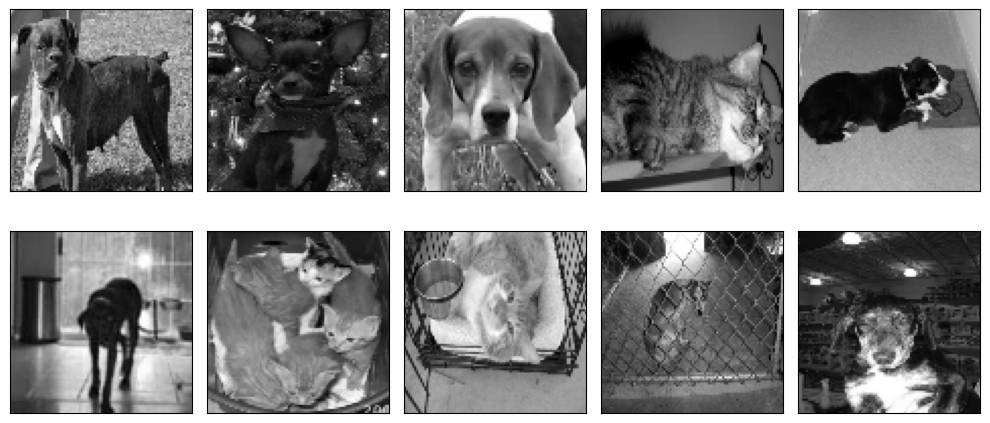

In [ ]:
import matplotlib.pyplot as plt

# Configurar el tamaño del gráfico
plt.figure(figsize=(10, 5))

# Visualizar las primeras 10 imágenes en una cuadrícula de 2x5
for i in range(10):
    plt.subplot(2, 5, i + 1)  # Crear un subgráfico (2 filas, 5 columnas)
    plt.imshow(X[i].squeeze(), cmap='gray')  # Visualizar la imagen eliminando la dimensión del canal
    plt.xticks([])  # Eliminar marcas del eje X
    plt.yticks([])  # Eliminar marcas del eje Y

# Mostrar la cuadrícula
plt.tight_layout()
plt.show()



# **Aumento de Datos**

Es una técnica para generar nuevos datos artificialmente, aplicando transformaciones y aplicaciones aleatorias a las imagenes preentrenadas del modelo original.

Esto ayuda a evitar durante el entrenamiento el overfitting (sobreentrenamiento) del modelo original

**Rotación**: Girar la imagen por un ángulo aleatorio, lo que simula imágenes vistas desde diferentes ángulos.
**Traslación:** Mover la imagen hacia la izquierda, derecha, arriba o abajo.
**Zoom**: Acercar o alejar una parte de la imagen.
Reflejo (flip): Voltear la imagen horizontal o verticalmente.
Deformación (shearing): Aplicar una deformación que inclina la imagen.
Cambio de brillo, contraste y saturación: Modificar la intensidad de los colores de la imagen.
Estiramiento o escalado: Cambiar el tamaño de la imagen de manera no uniforme, estirando o comprimiendo la imagen

In [ ]:
import tensorflow as tf

X_resized = tf.image.resize(X, (100, 100))  # Redimensiona a 100x100
print(X_resized.shape)  # Debería ser (23262, 100, 100, 1)


(23262, 100, 100, 1)


In [ ]:
print(X.shape)  # Debería ser algo como (n_samples, 100, 100, 1)


(23262, 90, 90, 1)


aReducir el modelo a 10 entrenamientos para efectos prácticos

In [ ]:
transboardCNN2 = TensorBoard(log_dir='logs/CNN2')
modeloConvolucional2.fit(X_resized, y, batch_size=32, validation_split=0.15, epochs=10, callbacks=[transboardCNN2])

Epoch 1/10
618/618 ━━━━━━━━━━━━━━━━━━━━ 332s 538ms/step - accuracy: 0.9425 - loss: 0.1533 - val_accuracy: 0.7688 - val_loss: 0.6124
Epoch 2/10
618/618 ━━━━━━━━━━━━━━━━━━━━ 374s 525ms/step - accuracy: 0.9490 - loss: 0.1295 - val_accuracy: 0.7590 - val_loss: 0.7089
Epoch 3/10
618/618 ━━━━━━━━━━━━━━━━━━━━ 380s 522ms/step - accuracy: 0.9652 - loss: 0.0980 - val_accuracy: 0.7662 - val_loss: 0.6981
Epoch 4/10
618/618 ━━━━━━━━━━━━━━━━━━━━ 380s 519ms/step - accuracy: 0.9727 - loss: 0.0805 - val_accuracy: 0.7679 - val_loss: 0.7407
Epoch 5/10
618/618 ━━━━━━━━━━━━━━━━━━━━ 314s 507ms/step - accuracy: 0.9753 - loss: 0.0752 - val_accuracy: 0.7696 - val_loss: 0.7401
Epoch 6/10
618/618 ━━━━━━━━━━━━━━━━━━━━ 329s 519ms/step - accuracy: 0.9816 - loss: 0.0566 - val_accuracy: 0.7536 - val_loss: 0.9020
Epoch 7/10
618/618 ━━━━━━━━━━━━━━━━━━━━ 318s 514ms/step - accuracy: 0.9813 - loss: 0.0521 - val_accuracy: 0.7656 - val_loss: 0.8075
Epoch 8/10
618/618 ━━━━━━━━━━━━━━━━━━━━ 324s 517ms/step - accuracy: 0.9842 -

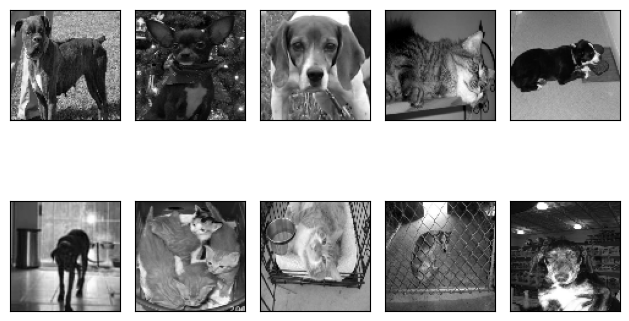

In [ ]:
for i in range(10):
    plt.subplot(2, 5, i + 1)
    plt.imshow(X[i].squeeze(), cmap='gray')
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.show()

In [ ]:
#Importar librerias para el aumento de datos
from tensorflow.keras.preprocessing.image import ImageDataGenerator

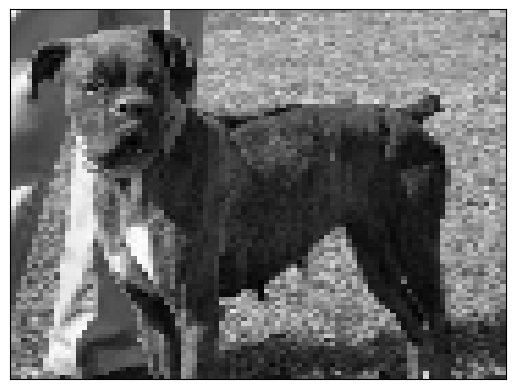

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Supongamos que 'X' tiene una imagen con dimensiones (90, 90)
# La imagen debe estar cargada en la variable X

i = 0  # Índice de la imagen que quieres visualizar
plt.imshow(X[i].squeeze(), cmap='gray', aspect='auto')  # 'aspect' ajusta la relación de aspecto
plt.xticks([])  # Elimina las marcas de los ejes x
plt.yticks([])  # Elimina las marcas de los ejes y
plt.show()


# Transformaciones a las imágenes del modelo

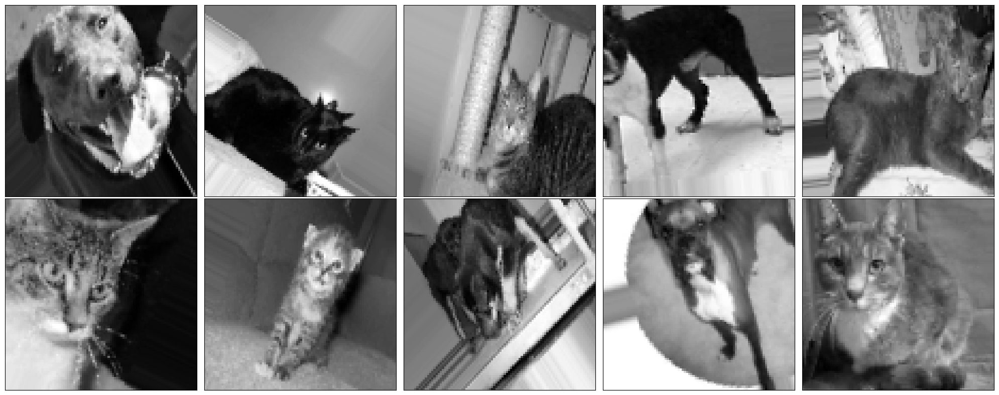

In [ ]:
#Transformar las imágenes
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt

# Crea un objeto ImageDataGenerator con transformaciones
datagen = ImageDataGenerator(
    rotation_range=40,  # Rotación aleatoria
    width_shift_range=0.2,  # Desplazamiento horizontal
    height_shift_range=0.2,  # Desplazamiento vertical
    shear_range=0.2,  # Desviación aleatoria (shearing)
    zoom_range=0.2,  # Zoom aleatorio
    horizontal_flip=True,  # Volteo horizontal
    fill_mode='nearest'  # Estrategia de relleno para nuevas áreas
)

# Ajustar el generador a tus datos
datagen.fit(X)

# Crear una figura para mostrar las imágenes transformadas
plt.figure(figsize=(20, 8))

# Generar y mostrar 10 imágenes transformadas
for i, (imagen, etiqueta) in enumerate(datagen.flow(X, y, batch_size=10, shuffle=False)):
    if i == 1:  # Solo visualizamos el primer lote de transformaciones
        for j in range(10):
            plt.subplot(2, 5, j + 1)
            plt.imshow(imagen[j].squeeze(), cmap='gray')
            plt.xticks([])  # Elimina las marcas de los ejes x
            plt.yticks([])  # Elimina las marcas de los ejes y
        break  # Detén el bucle después de mostrar 10 imágenes

plt.tight_layout()
plt.show()


## **Creando el modelo con aumento de datos**

In [ ]:
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Cargar el dataset X, y (por ejemplo, imágenes y etiquetas ya procesadas)

# Configurar el generador de aumento de datos
datagen = ImageDataGenerator(
    rotation_range=40,  # Rotación aleatoria
    width_shift_range=0.2,  # Desplazamiento horizontal
    height_shift_range=0.2,  # Desplazamiento vertical
    shear_range=0.2,  # Deformación aleatoria (shearing)
    zoom_range=0.2,  # Zoom aleatorio
    horizontal_flip=True,  # Volteo horizontal
    fill_mode='nearest'  # Estrategia de relleno para nuevas áreas
)

# Ajustar el generador de aumento de datos a tus imágenes
datagen.fit(X)

# Construir el modelo convolucional
modeloConvolucional = Sequential([
    # Primera capa convolucional
    Conv2D(32, (3, 3), activation='relu', input_shape=(100, 100, 1)),
    MaxPooling2D(2, 2),  # Reducción de tamaño

    # Segunda capa convolucional
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),  # Reducción de tamaño

    # Dropout para evitar sobreajuste
    Dropout(0.5),

    # Aplanar las salidas para conectarlas con la capa densa
    Flatten(),

    # Capa densa con 128 neuronas
    Dense(128, activation='relu'),

    # Capa de salida con 1 neurona para clasificación binaria
    Dense(1, activation='sigmoid')
])

# Compilar el modelo
modeloConvolucional.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Aquí ya tienes el modelo listo para ser entrenado con el generador de aumento de datos



Definir el inidice para el entrenamiento del modelo

In [ ]:
len(X) * .85 #19772.7 inidce para el entrenamiento
len(X) - 19772

#Crear dos variables, el x de entrenamiento y el x de validación
X_entrenamiento = X[:19772]
X_validacion = X[19772:]



#Preparar el entrenamiento de las etiquetas
y_entrenamiento = y[:19772]
y_validacion = y[19772:]

In [ ]:
gen_entrenado = datagen.flow(X_entrenamiento, y_entrenamiento, batch_size=32)
gen_validacion = datagen.flow(X_validacion, y_validacion, batch_size=32)

Preparar el data gen entrenado para el entrenamiento

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard
from tensorflow.keras.regularizers import l2
import tensorflow as tf
import numpy as np
import os

# Crear carpetas para guardar logs de TensorBoard
if not os.path.exists('logs'):
    os.mkdir('logs')

# 1. Redimensionar las imágenes
X_entrenamiento_redimensionado = tf.image.resize(X_entrenamiento, (100, 100)).numpy()
X_validacion_redimensionado = tf.image.resize(X_validacion, (100, 100)).numpy()

print(X_entrenamiento_redimensionado.shape)  # Asegúrate de que las dimensiones sean (n_samples, 100, 100, 1)

# 2. Configurar el aumento de datos
datagen = ImageDataGenerator(
    rotation_range=60,       # Mayor rotación
    width_shift_range=0.3,   # Desplazamiento horizontal
    height_shift_range=0.3,  # Desplazamiento vertical
    shear_range=0.3,         # Mayor deformación
    zoom_range=0.3,          # Mayor zoom
    horizontal_flip=True,    # Volteo horizontal
    brightness_range=(0.8, 1.2),  # Cambios en el brillo
    fill_mode='nearest'      # Estrategia de relleno
)

datagen.fit(X_entrenamiento_redimensionado)

# 3. Construcción del modelo
modeloConvolucional = Sequential([
    # Primera capa convolucional
    Conv2D(32, (3, 3), activation='relu', input_shape=(100, 100, 1), kernel_regularizer=l2(0.01)),
    MaxPooling2D(2, 2),

    # Segunda capa convolucional
    Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(0.01)),
    MaxPooling2D(2, 2),

    # Tercera capa convolucional
    Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(0.01)),
    MaxPooling2D(2, 2),

    # Dropout
    Dropout(0.5),

    # Aplanar y capas densas
    Flatten(),
    Dense(128, activation='relu', kernel_regularizer=l2(0.01)),
    Dropout(0.5),
    Dense(1, activation='sigmoid')  # Salida para clasificación binaria
])

# Compilar el modelo
modeloConvolucional.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# 4. Callbacks para EarlyStopping y TensorBoard
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
tensorboard = TensorBoard(log_dir='logs', histogram_freq=1)

# 5. Entrenar el modelo con el generador
history = modeloConvolucional.fit(
    datagen.flow(X_entrenamiento_redimensionado, y_entrenamiento, batch_size=32),  # Generador
    epochs=100,  # Máximo de épocas
    validation_data=(X_validacion_redimensionado, y_validacion),  # Datos de validación
    steps_per_epoch=len(X_entrenamiento_redimensionado) // 32,
    validation_steps=len(X_validacion_redimensionado) // 32,
    callbacks=[early_stopping, tensorboard]  # Callbacks
)

# 6. Visualizar resultados
import matplotlib.pyplot as plt

# Pérdida
plt.plot(history.history['loss'], label='Entrenamiento')
plt.plot(history.history['val_loss'], label='Validación')
plt.title('Pérdida')
plt.legend()
plt.show()

# Precisión
plt.plot(history.history['accuracy'], label='Entrenamiento')
plt.plot(history.history['val_accuracy'], label='Validación')
plt.title('Precisión')
plt.legend()
plt.show()


(19772, 100, 100, 1)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


617/617 ━━━━━━━━━━━━━━━━━━━━ 0s 646ms/step - accuracy: 0.5010 - loss: 0.9988

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


617/617 ━━━━━━━━━━━━━━━━━━━━ 423s 681ms/step - accuracy: 0.5009 - loss: 0.9984 - val_accuracy: 0.4914 - val_loss: 0.6932
Epoch 2/100
617/617 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - accuracy: 0.5312 - loss: 0.6933 - val_accuracy: 0.4914 - val_loss: 0.6932
Epoch 3/100
617/617 ━━━━━━━━━━━━━━━━━━━━ 413s 668ms/step - accuracy: 0.5025 - loss: 0.6931 - val_accuracy: 0.4914 - val_loss: 0.6933
Epoch 4/100
617/617 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - accuracy: 0.5000 - loss: 0.6926 - val_accuracy: 0.4914 - val_loss: 0.6933
Epoch 5/100
617/617 ━━━━━━━━━━━━━━━━━━━━ 407s 660ms/step - accuracy: 0.4972 - loss: 0.6932 - val_accuracy: 0.4914 - val_loss: 0.6932
Epoch 6/100
617/617 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - accuracy: 0.5938 - loss: 0.6926 - val_accuracy: 0.4914 - val_loss: 0.6932
Epoch 7/100
617/617 ━━━━━━━━━━━━━━━━━━━━ 407s 659ms/step - accuracy: 0.5023 - loss: 0.6932 - val_accuracy: 0.4914 - val_loss: 0.6933
Epoch 8/100
617/617 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - accuracy: 0.6250 - loss: 0.692

In [ ]:
%tensorboard --logdir logs/


Reusing TensorBoard on port 6006 (pid 55727), started 2:02:34 ago. (Use '!kill 55727' to kill it.)

<IPython.core.display.Javascript object>